In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!nvidia-smi

Tue Aug 30 05:22:42 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## I. Download Dataset

### 1.1 OCR_Dataset
https://github.com/pbcquoc/vietocr

In [ ]:
# ! gdown https://drive.google.com/uc?id=1T0cmkhTgu3ahyMIwGZeby612RpVdDxOR
# ! unzip -qq -o ./ocr_dataset.zip -d datasetOCR

In [ ]:
%cd /content
!git clone https://github.com/thangquocdang/datasetOCR.git

/content
Cloning into 'datasetOCR'...
remote: Enumerating objects: 1184960, done.
remote: Counting objects: 100% (386491/386491), done.
remote: Compressing objects: 100% (267697/267697), done.
remote: Total 1184960 (delta 1416), reused 386490 (delta 1415), pack-reused 798469
Receiving objects: 100% (1184960/1184960), 7.03 GiB | 17.62 MiB/s, done.
Resolving deltas: 100% (1482/1482), done.
Checking out files: 100% (1202564/1202564), done.


In [ ]:
%cd /content
! gdown --id 1uMVd6EBjY4Q0G2IkU5iMOQ34X0bysm0b
! unzip  -qq -o sample.zip

/content
/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1uMVd6EBjY4Q0G2IkU5iMOQ34X0bysm0b
To: /content/sample.zip
100% 306k/306k [00:00<00:00, 113MB/s]


### 1.2 Vietnamese_Dataset
https://github.com/VinAIResearch/dict-guided#dataset

Input format: x1,y1,x2,y2,x3,y3,x4,y4,TRANSCRIPT

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/Dataset
# !gdown https://drive.google.com/uc?id=1UUQhNvzgpZy7zXBFQp0Qox-BBjunZ0ml
# !unzip vietnamese_original.zip

### 1.3 QNAI Dataset

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/Dataset
# !gdown https://drive.google.com/uc?id=1dpbsK9bNklcE4FQ7WuEvT6wHo48ARM9y
# !unzip AI_Hackathon_Problem1.zip

## II. Clone Code PaddleOCR

In [ ]:
!rm -rf /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR
!git clone https://github.com/PaddlePaddle/PaddleOCR.git

/content/drive/MyDrive/QNAI_T/E2E/PPOCR
Cloning into 'PaddleOCR'...
remote: Enumerating objects: 42076, done.
remote: Counting objects: 100% (316/316), done.
remote: Compressing objects: 100% (210/210), done.
remote: Total 42076 (delta 169), reused 214 (delta 106), pack-reused 41760
Receiving objects: 100% (42076/42076), 335.85 MiB | 15.50 MiB/s, done.
Resolving deltas: 100% (29576/29576), done.
Checking out files: 100% (1519/1519), done.


## III. Install Enviroment

In [3]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!pip install -r requirements.txt
!pip install paddlepaddle-gpu 
!pip install PyYAML==5.4.1
!pip3 install paddleslim==2.2.2
!pip install split-folders
!pip3 install lanms-nova

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 604 kB 8.4 MB/s 
     |████████████████████████████████| 4.9 MB 31.1 MB/s 
     |████████████████████████████████| 2.2 MB 58.1 MB/s 
     |████████████████████████████████| 204 kB 66.6 MB/s 
     |████████████████████████████████| 104 kB 66.4 MB/s 
     |████████████████████████████████| 399 kB 66.9 MB/s 
     |████████████████████████████████| 2.3 MB 54.7 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 394.0 MB 22 kB/s 
     |████████████████████████████████| 394 kB 26.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 636 kB 6.9 MB/s 
  Attempting uninstall: P

## IV. Text Detection

https://github.com/PaddlePaddle/PaddleOCR/blob/release/2.5/doc/doc_en/detection_en.md

### 4.1 Image Processing

In [ ]:
import os

path = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/test_image'
files_test_image = os.listdir(path)
print('len_test: ', len(files_test_image))
print('min_test: ', min(files_test_image))
print('max_test: ', max(files_test_image))

len_test:  300
min_test:  im1201.jpg
max_test:  im1500.jpg


In [ ]:
import os

path = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/train_images'
files = os.listdir(path)
print('len_train: ', len(files))
print('min_train: ', min(files))
print('max_train: ', max(files))

len_train:  1200
min_train:  im0001.jpg
max_train:  im1200.jpg


In [ ]:
import os

path = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/unseen_test_images'
files = os.listdir(path)
print('len_unseen: ', len(files))
print('min_unseen: ', min(files))
print('max_unseen: ', max(files))

len_unseen:  500
min_unseen:  im1501.jpg
max_unseen:  im2000.jpg


In [ ]:
import os

path = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/labels'
files = [int(fl.split('.txt')[0].split('_')[1]) for fl in os.listdir(path)]
print('len_label: ', len(files))
print('min_label: ', min(files))
print('max_label: ', max(files))

len_label:  2000
min_label:  1
max_label:  2000


#### Format data

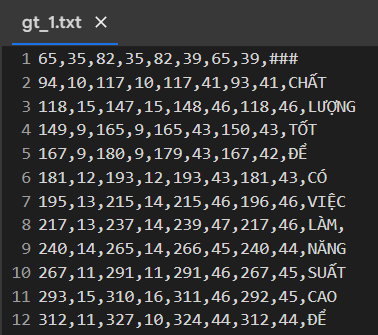

Text Detection: https://github.com/PaddlePaddle/PaddleOCR/blob/release/2.5/doc/doc_en/dataset/ocr_datasets_en.md

Data format: https://github.com/PaddlePaddle/PaddleOCR/blob/release/2.5/doc/doc_en/dataset/ocr_datasets_en.md

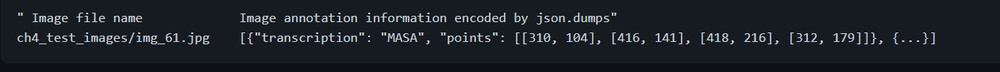

In [ ]:
import glob 
import json
import cv2

path = glob.glob('/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/labels/*')

train_label = open("/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/train_label.txt","w")
test_label = open("/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/test_label.txt","w")
useen_label = open("/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/useen_label.txt","w")

for file in path:
  with open(file, 'r') as f:
    lines = f.readlines()
  
  label = []
  for line in lines:
    line = line.strip()
    text_box = {}
    c = line.split(',', 8)
    text_box["transcription"] = c[-1]
    text_box["points"] = [[c[0],c[1]],[c[2],c[3]], [c[4],c[5]],[c[6],c[7]]]
    label.append(text_box)

  label = json.dumps(label, ensure_ascii=False)
  label_name = os.path.basename(file).split('.')[0].split('_')[1]
  int_number = int(label_name)
  img_name = 'im' + "{:04n}".format(int(int_number)) + '.jpg'

  if int_number <= 1200:
    train_label.write('train_images/' + img_name + '\t' + f'{label}' + '\n')
  elif int_number > 1500:
    useen_label.write('unseen_test_images/' + img_name + '\t' + f'{label}' + '\n')
  else:
    test_label.write('test_image/' + img_name + '\t' + f'{label}' + '\n')
  cv2.waitKey(1)

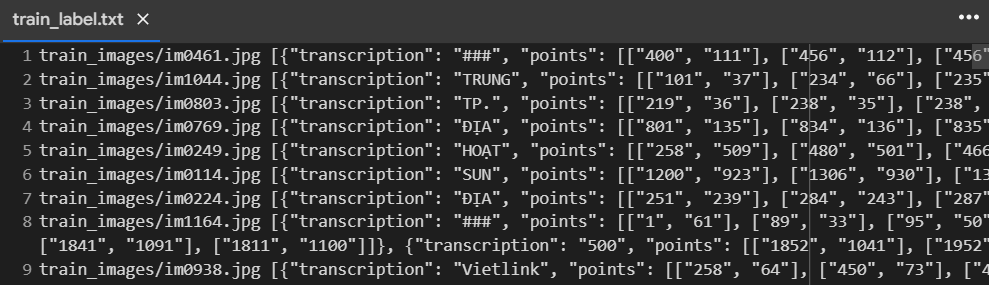

In [ ]:
import os

test_label = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/test_label.txt'
with open(test_label, 'r') as f:
  lines = f.readlines()
  cv2.waitKey(1)
print("test_label: {}".format(len(lines)))

train_label = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/train_label.txt'
with open(train_label, 'r') as f:
  lines = f.readlines()
  cv2.waitKey(1)
print("train_labels: {}".format(len(lines)))

useen_label = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/useen_label.txt'
with open(useen_label, 'r') as f:
  lines = f.readlines()
  cv2.waitKey(1)
print("useen_label: {}".format(len(lines)))

test_label: 300
train_labels: 1200
useen_label: 500


### 4.2 Download pretrain model


#### EAST

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR
# !wget -P ./pretrain_models/ https://paddleocr.bj.bcebos.com/dygraph_v2.0/en/det_r50_vd_east_v2.0_train.tar
# # Decompress model parameters
# %cd pretrain_models
# !tar -xf det_r50_vd_east_v2.0_train.tar && rm -rf det_r50_vd_east_v2.0_train.tar

/content/drive/MyDrive/QNAI/E2E/PPOCR/PaddleOCR


#### SAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR
!wget -P ./pretrain_models/ https://paddleocr.bj.bcebos.com/dygraph_v2.0/en/det_r50_vd_sast_icdar15_v2.0_train.tar
# Decompress model parameters
%cd pretrain_models
!tar -xf det_r50_vd_sast_icdar15_v2.0_train.tar && rm -rf det_r50_vd_sast_icdar15_v2.0_train.tar

/content/drive/MyDrive/QNAI_T/E2E/PPOCR
--2022-08-10 12:47:34--  https://paddleocr.bj.bcebos.com/dygraph_v2.0/en/det_r50_vd_sast_icdar15_v2.0_train.tar
Resolving paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)... 103.235.46.61, 2409:8c04:1001:1002:0:ff:b001:368a
Connecting to paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)|103.235.46.61|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1041520640 (993M) [application/x-tar]
Saving to: ‘./pretrain_models/det_r50_vd_sast_icdar15_v2.0_train.tar’

det_r50_vd_sast_icd 100%[===================>] 993.27M  10.4MB/s    in 2m 12s  

2022-08-10 12:49:48 (7.54 MB/s) - ‘./pretrain_models/det_r50_vd_sast_icdar15_v2.0_train.tar’ saved [1041520640/1041520640]

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/pretrain_models


### 4.3 Traning

#### 4.3.1 Start training

##### Normal

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/train.py -c configs/det/custom.yml

##### Quantization

###### EAST

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# !python3 deploy/slim/quantization/quant.py \
#  -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_r50_east_custom.yml \
#  -o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/pretrain_models/det_r50_vd_east_v2.0_train/best_accuracy \
#   Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/det_east

###### SAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/quant.py \
 -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/sast_custom.yml \
 -o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/pretrain_models/det_r50_vd_sast_icdar15_v2.0_train/best_accuracy \
  Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/det_sast

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-10 12:50:30,620-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-10 12:50:30,620-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
Traceback (most recent call last):
  File "deploy/slim/quantization/quant.py", line 203, in <module>
    config, device, logger, vdl_writer = program.preprocess(is_train=True)
  File "/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/tools/program.py", line 537, in preprocess
    config = load_config(FLAGS.config)
  File "/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/tools/program.py", line 82, in load_config
    config = yaml.load(open(file_path, 'rb'), Loader=yaml.Loader)
FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/sast_custom.yml'


#### 4.3.2 Load Trained Model and Continue Training

In [ ]:
# !python3 tools/train.py -c configs/det/det_mv3_db.yml -o Global.checkpoints=./your/trained/model

## V. Text Recognition

Text Recognition: https://github.com/PaddlePaddle/PaddleOCR/blob/release/2.5/doc/doc_en/recognition_en.md

### 5.1 Image Processing

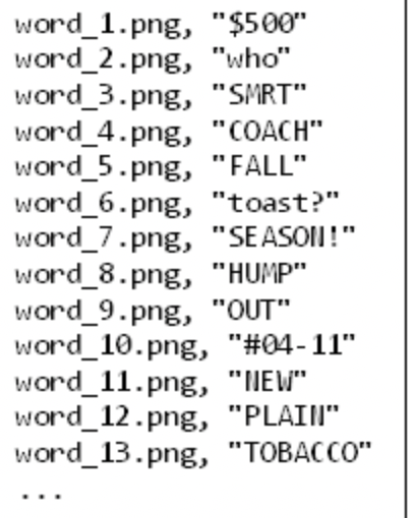

#### 5.1.1 Vietnamese_Data

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

import json
import os
import cv2
import copy
import numpy as np
from tools.infer.utility import draw_ocr_box_txt, get_rotate_crop_image

def print_draw_crop_rec_res( img_crop_list, img_name):
        bbox_num = len(img_crop_list)
        for bno in range(bbox_num):
          crop_name=img_name+'_'+str(bno)+'.jpg'
          crop_name_w = "/content/dataset_crop/{}".format(crop_name)
          cv2.imwrite(crop_name_w, img_crop_list[bno])
          crop_label.write("{0}\t{1}\n".format(crop_name, text[bno]))
          cv2.waitKey(1)

crop_label = open('/content/dataset_crop/crop_label.txt','w')
with open('/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/train_label.txt','r') as file_text:
  img_files=file_text.readlines()
  
count=0
for img_file in img_files:
  content = json.loads(img_file.split('\t')[1].strip())

  dt_boxes=[]
  text=[]
  
  for i in content:
    content = i['points']
    if i['transcription'] == "###":
      count+=1
      continue
    bb = np.array(i['points'],dtype=np.float32)
    dt_boxes.append(bb)
    text.append(i['transcription'])

  image_file = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/' + img_file.split('\t')[0]
  img = cv2.imread(image_file)
  ori_im=img.copy()
  img_crop_list=[]

  for bno in range(len(dt_boxes)):
    tmp_box = copy.deepcopy(dt_boxes[bno])
    img_crop = get_rotate_crop_image(ori_im, tmp_box)
    img_crop_list.append(img_crop)
  img_name = img_file.split('\t')[0].split('.')[0]
  
  if not os.path.exists('/content/dataset_crop/train_images'):
    os.makedirs('/content/dataset_crop/train_images') 
  print_draw_crop_rec_res(img_crop_list,img_name)

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR


In [ ]:
import os

with open('/content/dataset_crop/crop_label.txt', 'r') as f:
  lines = f.readlines()
  cv2.waitKey(10)

files = os.listdir('/content/dataset_crop/train_images')

print(len(lines))
print(len(files))

25794
25794


In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
import json
import os
import cv2
import copy
import numpy as np
from tools.infer.utility import draw_ocr_box_txt, get_rotate_crop_image

def print_draw_crop_rec_res( img_crop_list, img_name):
        bbox_num = len(img_crop_list)
        for bno in range(bbox_num):
          crop_name=img_name+'_'+str(bno)+'.jpg'
          crop_name_w = "/content/dataset_crop/{}".format(crop_name)
          cv2.imwrite(crop_name_w, img_crop_list[bno])
          crop_label.write("{0}\t{1}\n".format(crop_name, text[bno]))
          cv2.waitKey(1)

crop_label = open('/content/dataset_crop/crop_test_label.txt','w')
with open('/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/test_label.txt','r') as file_text:
  img_files=file_text.readlines()
  
count=0
for img_file in img_files:
  content = json.loads(img_file.split('\t')[1].strip())

  dt_boxes=[]
  text=[]
  
  for i in content:
    content = i['points']
    if i['transcription'] == "###":
      count+=1
      continue
    bb = np.array(i['points'],dtype=np.float32)
    dt_boxes.append(bb)
    text.append(i['transcription'])

  image_file = '/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/' + img_file.split('\t')[0]
  img = cv2.imread(image_file)
  ori_im=img.copy()
  img_crop_list=[]

  for bno in range(len(dt_boxes)):
    tmp_box = copy.deepcopy(dt_boxes[bno])
    img_crop = get_rotate_crop_image(ori_im, tmp_box)
    img_crop_list.append(img_crop)
  img_name = img_file.split('\t')[0].split('.')[0]
  
  if not os.path.exists('/content/dataset_crop/test_image'):
    os.makedirs('/content/dataset_crop/test_image') 
  print_draw_crop_rec_res(img_crop_list,img_name)

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR


In [ ]:
import os

with open('/content/dataset_crop/crop_test_label.txt', 'r') as f:
  lines = f.readlines()

files = os.listdir('/content/dataset_crop/test_image')

print(len(lines))
print(len(files))

7220
7220


#### Data_Menu_Label_Sentences

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

import json
import os
import cv2
import copy
import numpy as np
from tools.infer.utility import draw_ocr_box_txt, get_rotate_crop_image

def print_draw_crop_rec_res( img_crop_list, img_name):
        bbox_num = len(img_crop_list)
        for bno in range(bbox_num):
          crop_name=img_name+'_'+str(bno)+'.jpg'
          crop_name_w = "/content/dataset_crop/train_images_menu/{}".format(crop_name)
          cv2.imwrite(crop_name_w, img_crop_list[bno])
          crop_label.write("{0}\t{1}\n".format('train_images_menu/'+crop_name, text[bno]))
          cv2.waitKey(10)

crop_label = open('/content/dataset_crop/crop_label_menu.txt','w')
with open('/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/label_sentences.txt','r') as file_text:
  img_files=file_text.readlines()
  
count=0
for img_file in img_files:
  content = json.loads(img_file.split('\t')[1].strip())

  dt_boxes=[]
  text=[]
  
  for i in content:
    content = i['points']
    if i['transcription'] == "###":
      count+=1
      continue
    bb = np.array(i['points'],dtype=np.float32)
    dt_boxes.append(bb)
    text.append(i['transcription'])

  image_file = '/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/' + img_file.split('\t')[0]
  img = cv2.imread(image_file)
  ori_im=img.copy()
  img_crop_list=[]

  for bno in range(len(dt_boxes)):
    tmp_box = copy.deepcopy(dt_boxes[bno])
    img_crop = get_rotate_crop_image(ori_im, tmp_box)
    img_crop_list.append(img_crop)
  img_name = img_file.split('\t')[0].split('.')[0]
  
  if not os.path.exists('/content/dataset_crop/train_images_menu'):
    os.makedirs('/content/dataset_crop/train_images_menu') 
  print_draw_crop_rec_res(img_crop_list,img_name)

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR


In [ ]:
import os

with open('/content/dataset_crop/crop_label_menu.txt', 'r') as f:
  lines = f.readlines()
  cv2.waitKey(10)

files = os.listdir('/content/dataset_crop/train_images_menu')

print(len(lines))
print(len(files))

10258
10258


#### Data_Menu_Label_Char

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

import json
import os
import cv2
import copy
import numpy as np
from tools.infer.utility import draw_ocr_box_txt, get_rotate_crop_image

def print_draw_crop_rec_res( img_crop_list, img_name):
        bbox_num = len(img_crop_list)
        for bno in range(bbox_num):
          crop_name=img_name+'_'+str(bno)+'.jpg'
          crop_name_w = "/content/dataset_crop/train_images_char/{}".format(crop_name)
          cv2.imwrite(crop_name_w, img_crop_list[bno])
          crop_label.write("{0}\t{1}\n".format('train_images_char/'+crop_name, text[bno]))
          cv2.waitKey(100)

crop_label = open('/content/dataset_crop/crop_label_char.txt','w')
with open('/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/label_char.txt','r') as file_text:
  img_files=file_text.readlines()
  
count=0
for img_file in img_files:
  content = json.loads(img_file.split('\t')[1].strip())

  dt_boxes=[]
  text=[]
  
  for i in content:
    content = i['points']
    if i['transcription'] == "###":
      count+=1
      continue
    bb = np.array(i['points'],dtype=np.float32)
    dt_boxes.append(bb)
    text.append(i['transcription'])

  image_file = '/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/' + img_file.split('\t')[0]
  img = cv2.imread(image_file)
  ori_im=img.copy()
  img_crop_list=[]

  for bno in range(len(dt_boxes)):
    tmp_box = copy.deepcopy(dt_boxes[bno])
    img_crop = get_rotate_crop_image(ori_im, tmp_box)
    img_crop_list.append(img_crop)
  img_name = img_file.split('\t')[0].split('.')[0]
  
  if not os.path.exists('/content/dataset_crop/train_images_char'):
    os.makedirs('/content/dataset_crop/train_images_char') 
  print_draw_crop_rec_res(img_crop_list,img_name)

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR


In [ ]:
import os

with open('/content/dataset_crop/crop_label_char.txt', 'r') as f:
  lines = f.readlines()
  cv2.waitKey(10)

files = os.listdir('/content/dataset_crop/train_images_char')

print(len(lines))
print(len(files))

14729
11383


#### 5.1.2 OCR_Dataset

In [ ]:
import glob 
import json
import os
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

def split_txt_file(path):
  with open(path, 'r') as f:
    lines = f.readlines()

  list_label_train, list_label_val = train_test_split(lines, test_size=0.1, shuffle=True)
  # list_label_train, list_label_test = train_test_split(list_label, test_size=0.2, shuffle=True)

  train_path = '/content/datasetOCR/train_' + path.split('/')[-1]
  # test_path = '/content/datasetOCR/test_' + path.split('/')[-1]
  val_path = '/content/datasetOCR/val_' + path.split('/')[-1]
  # with open(test_path, 'w') as fi:
  #     for line in list_label_test:
  #         fi.write(line)

  with open(train_path, 'w') as fi:
      for line in list_label_train:
          fi.write(line)
  
  with open(val_path, 'w') as fi:
      for line in list_label_val:
          fi.write(line)

def create_txt_file(folder_path, tail_image_file='.jpg'):
  path = folder_path + '.txt'
  txt_files = glob.glob(folder_path + '/*.txt')
  new_file = open(path, "w")

  for file in txt_files:
    with open(file, 'r') as f:
      line = f.read()
    label_name = os.path.basename(file).split('.')[0]
    img_name = folder_path.split('/')[-1] + '/' + label_name + tail_image_file
    new_file.write("{0}\t{1}\n".format(img_name, line))

  split_txt_file(path)

In [ ]:
# ## random
# path = '/content/datasetOCR/random'
# create_txt_file(path)

# ## InkData_line_processed
# path = '/content/datasetOCR/InkData_line_processed'
# create_txt_file(path, '.png')

# ## en_00
# path = '/content/datasetOCR/en_00'
# create_txt_file(path)

# ## en_01
# path = '/content/datasetOCR/en_01'
# create_txt_file(path)

# ## vn_00
# path = '/content/datasetOCR/vn_00'
# create_txt_file(path)

# ## vn_01
# path = '/content/datasetOCR/vn_01'
# create_txt_file(path)

# ## meta
# path = '/content/datasetOCR/meta'
# create_txt_file(path)


In [ ]:
# folder_paths = '/content/datasetOCR'
# folder_path = glob.glob(folder_paths + '/*')
# path_new_file = '/content/datasetOCR/dataocr.txt'
# new_file = open(path_new_file, "w")

# for folder in folder_path:
#   if folder == '/content/datasetOCR/random':
#     continue
#   if folder == '/content/datasetOCR/InkData_line_processed':
#     tail_image_file='.png'
#   else:   
#     tail_image_file='.jpg'

#   txt_files = glob.glob(folder + '/*.txt')
#   for file in txt_files:
#     with open(file, 'r') as f:
#       lines = f.readlines()

#     label_name = os.path.basename(file).split('.')[0]
#     img_name = folder.split('/')[-1] + '/' + label_name + tail_image_file
#     for line in lines:
#       new_file.write("{0}\t{1}\n".format(img_name, line.rstrip()))

# split_txt_file(path_new_file)

### 5.2 Dictionary

In [ ]:
# !cp /content/drive/MyDrive/QNAI_T/Dataset/vietnamese/vn_dictionary.txt /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/ppocr/utils/dict

### 5.3 Download Pretrained Model

#### 5.3.1 Normal

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# # Download the pre-trained model of en_PP-OCRv3
# !wget -P ./pretrain_models/ https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_rec_train.tar

# # Decompress model parameters
# %cd pretrain_models
# !tar -xf en_PP-OCRv3_rec_train.tar && rm -rf en_PP-OCRv3_rec_train.tar

#### 5.3.2 Quantization

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# # Download the pre-trained model of en_PP-OCRv3
# !wget -P ./pretrain_models/ https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_rec_slim_train.tar

# # Decompress model parameters
# %cd pretrain_models
# !tar -xf en_PP-OCRv3_rec_slim_train.tar && rm -rf en_PP-OCRv3_rec_slim_train.tar

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
--2022-08-09 07:36:21--  https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_rec_slim_train.tar
Resolving paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)... 103.235.46.61, 2409:8c04:1001:1002:0:ff:b001:368a
Connecting to paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)|103.235.46.61|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 201349120 (192M) [application/x-tar]
Saving to: ‘./pretrain_models/en_PP-OCRv3_rec_slim_train.tar’

en_PP-OCRv3_rec_sli 100%[===================>] 192.02M  8.40MB/s    in 40s     

2022-08-09 07:37:03 (4.80 MB/s) - ‘./pretrain_models/en_PP-OCRv3_rec_slim_train.tar’ saved [201349120/201349120]

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR/pretrain_models


In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# Download the pre-trained model of en_PP-OCRv3
!wget -P ./pretrain_models/ https://paddleocr.bj.bcebos.com/PP-OCRv3/chinese/rec_svtr_tiny_none_ctc_en_train.tar

# Decompress model parameters
%cd pretrain_models
!tar -xf rec_svtr_tiny_none_ctc_en_train.tar && rm -rf rec_svtr_tiny_none_ctc_en_train.tar

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
--2022-08-09 07:57:04--  https://paddleocr.bj.bcebos.com/PP-OCRv3/chinese/rec_svtr_tiny_none_ctc_en_train.tar
Resolving paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)... 220.181.33.43, 220.181.33.44, 2409:8c04:1001:1002:0:ff:b001:368a
Connecting to paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)|220.181.33.43|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24135680 (23M) [application/x-tar]
Saving to: ‘./pretrain_models/rec_svtr_tiny_none_ctc_en_train.tar’

rec_svtr_tiny_none_ 100%[===================>]  23.02M  2.85MB/s    in 32s     

2022-08-09 07:57:39 (726 KB/s) - ‘./pretrain_models/rec_svtr_tiny_none_ctc_en_train.tar’ saved [24135680/24135680]

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR/pretrain_models


### 5.3 Training

#### 5.3.1 Training

##### Normal

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# !python3 tools/train.py -c configs/rec/PP-OCRv3/en_PP-OCRv3_rec.yml -o Global.pretrained_model=pretrain_models/en_PP-OCRv3_rec_train/best_accuracy

##### Quantization

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# !python3 deploy/slim/quantization/quant.py \
#  -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_quanz_custom.yml \
#  -o Global.pretrained_model=./pretrain_models/en_PP-OCRv3_rec_slim_train/best_accuracy \
#   Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/quant_model

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/quant.py \
 -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
 -o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/pretrain_models/rec_svtr_tiny_none_ctc_en_train/best_accuracy \
  Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/svtr_model

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-09 09:31:28,063-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-09 09:31:28,063-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/09 09:31:28] ppocr INFO: Architecture : 
[2022/08/09 09:31:28] ppocr INFO:     Backbone : 
[2022/08/09 09:31:28] ppocr INFO:         depth : [3, 6, 3]
[2022/08/09 09:31:28] ppocr INFO:         embed_dim : [64, 128, 256]
[2022/08/09 09:31:28] ppocr INFO:         img_size : [32, 100]
[2022/08/09 09:31:28] ppocr INFO:         last_stage : True
[2022/08/09 09:31:28] ppocr INFO:         local_mixer : [[7, 11], [7, 11], [7, 11]]
[2022/08/09 09:31:28] ppocr INFO:         mixer : ['Local', 'Local', 'Local', 'Local', 'Local', 'Local', 'Global', 'Global', 'Global', 'Global', 'Global', 'Global']
[2022/08/09 09:31:28] ppocr INF

#### 5.3.2 Load Trained Model and Continue Training

In [ ]:
# !python3 tools/train.py -c configs/rec/rec_icdar15_train.yml -o Global.checkpoints=./your/trained/model

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# !python3 deploy/slim/quantization/quant.py \
# -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_quanz_custom.yml \
# -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/quant_model/best_accuracy

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/quant.py \
 -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
 -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/svtr_model/latest \
 Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/svtr_model

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-09 16:31:36,323-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-09 16:31:36,323-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/09 16:31:36] ppocr INFO: Architecture : 
[2022/08/09 16:31:36] ppocr INFO:     Backbone : 
[2022/08/09 16:31:36] ppocr INFO:         depth : [3, 6, 3]
[2022/08/09 16:31:36] ppocr INFO:         embed_dim : [64, 128, 256]
[2022/08/09 16:31:36] ppocr INFO:         img_size : [32, 100]
[2022/08/09 16:31:36] ppocr INFO:         last_stage : True
[2022/08/09 16:31:36] ppocr INFO:         local_mixer : [[7, 11], [7, 11], [7, 11]]
[2022/08/09 16:31:36] ppocr INFO:         mixer : ['Local', 'Local', 'Local', 'Local', 'Local', 'Local', 'Global', 'Global', 'Global', 'Global', 'Global', 'Global']
[2022/08/09 16:31:36] ppocr INF

## VI. Evaluation - Chỉ sử dụng cho Normal

### 6.1 Text Detection

#### 6.1.1 Evaluation

##### FCE

In [ ]:
#evaluation model detect 
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/eval.py -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_fce_custom.yml \
                       -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_fce/iter_epoch_300 \
                       PostProcess.box_thresh=0.6 PostProcess.unclip_ratio=1.5

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/17 15:16:46] ppocr INFO: Architecture : 
[2022/08/17 15:16:46] ppocr INFO:     Backbone : 
[2022/08/17 15:16:46] ppocr INFO:         dcn_stage : [False, True, True, True]
[2022/08/17 15:16:46] ppocr INFO:         layers : 50
[2022/08/17 15:16:46] ppocr INFO:         name : ResNet
[2022/08/17 15:16:46] ppocr INFO:         out_indices : [1, 2, 3]
[2022/08/17 15:16:46] ppocr INFO:     Head : 
[2022/08/17 15:16:46] ppocr INFO:         fourier_degree : 5
[2022/08/17 15:16:46] ppocr INFO:         name : FCEHead
[2022/08/17 15:16:46] ppocr INFO:     Neck : 
[2022/08/17 15:16:46] ppocr INFO:         extra_stage : 0
[2022/08/17 15:16:46] ppocr INFO:         has_extra_convs : False
[2022/08/17 15:16:46] ppocr INFO:         name : FCEFPN
[2022/08/17 15:16:46] ppocr INFO:         out_channels : 256
[2022/08/17 15:16:46] ppocr INFO:     Transform : None
[2022/08/17 15:16:46] ppocr INFO:     

##### PPOCR-V2

In [ ]:
#evaluation model detect 
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/eval.py -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_ppocrv2_custom.yml \
                       -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_ppocrv2_quant/latest \
                       PostProcess.box_thresh=0.6 PostProcess.unclip_ratio=1.5

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/15 04:10:45] ppocr INFO: Architecture : 
[2022/08/15 04:10:45] ppocr INFO:     Models : 
[2022/08/15 04:10:45] ppocr INFO:         Student : 
[2022/08/15 04:10:45] ppocr INFO:             Backbone : 
[2022/08/15 04:10:45] ppocr INFO:                 disable_se : True
[2022/08/15 04:10:45] ppocr INFO:                 model_name : large
[2022/08/15 04:10:45] ppocr INFO:                 name : MobileNetV3
[2022/08/15 04:10:45] ppocr INFO:                 scale : 0.5
[2022/08/15 04:10:45] ppocr INFO:             Head : 
[2022/08/15 04:10:45] ppocr INFO:                 k : 50
[2022/08/15 04:10:45] ppocr INFO:                 name : DBHead
[2022/08/15 04:10:45] ppocr INFO:             Neck : 
[2022/08/15 04:10:45] ppocr INFO:                 name : DBFPN
[2022/08/15 04:10:45] ppocr INFO:                 out_channels : 96
[2022/08/15 04:10:45] ppocr INFO:             algorithm : DB
[2022/08/15 04:10:45] ppocr INFO:             freeze

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:10:49] ppocr WARNING: Teacher.backbone.bb_2_0.conv0._batch_norm._mean not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



onv0._conv._ma_output_scale._scale', 'Teacher.backbone.bb_0_0.conv0._conv._ma_output_scale._state', 'Teacher.backbone.bb_0_0.conv0._conv._ma_output_scale._accum', 'Teacher.backbone.bb_0_0.conv0._batch_norm._layer.weight', 'Teacher.backbone.bb_0_0.conv0._batch_norm._layer.bias', 'Teacher.backbone.bb_0_0.conv0._batch_norm._layer._mean', 'Teacher.backbone.bb_0_0.conv0._batch_norm._layer._variance', 'Teacher.backbone.bb_0_0.conv0._batch_norm._ma_output_scale._scale', 'Teacher.backbone.bb_0_0.conv0._batch_norm._ma_output_scale._state', 'Teacher.backbone.bb_0_0.conv0._batch_norm._ma_output_scale._accum', 'Teacher.backbone.bb_0_0.conv1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.bb_0_0.conv1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.bb_0_0.conv1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.bb_0_0.conv1._conv._layer.weight', 'Teacher.backbone.bb_0_0.conv1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.bb_0_0.conv1._conv._layer._fake_quant_input.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:10:57] ppocr WARNING: Student.backbone.stage0.2.bottleneck_conv.conv.weight not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:01] ppocr WARNING: Student.backbone.stage2.1.linear_conv.bn._mean not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer._

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



_ma_output_scale._accum', 'Student.backbone.stage0.2.expand_conv.conv._layer.weight', 'Student.backbone.stage0.2.expand_conv.conv._layer._fake_quant_weight._scale', 'Student.backbone.stage0.2.expand_conv.conv._layer._fake_quant_input._scale', 'Student.backbone.stage0.2.expand_conv.conv._layer._fake_quant_input._state', 'Student.backbone.stage0.2.expand_conv.conv._layer._fake_quant_input._accum', 'Student.backbone.stage0.2.expand_conv.conv._ma_output_scale._scale', 'Student.backbone.stage0.2.expand_conv.conv._ma_output_scale._state', 'Student.backbone.stage0.2.expand_conv.conv._ma_output_scale._accum', 'Student.backbone.stage0.2.expand_conv.bn._layer.weight', 'Student.backbone.stage0.2.expand_conv.bn._layer.bias', 'Student.backbone.stage0.2.expand_conv.bn._layer._mean', 'Student.backbone.stage0.2.expand_conv.bn._layer._variance', 'Student.backbone.stage0.2.expand_conv.bn._ma_output_scale._scale', 'Student.backbone.stage0.2.expand_conv.bn._ma_output_scale._state', 'Student.backbone.stage

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:04] ppocr WARNING: Student.backbone.stage2.5.linear_conv.bn.bias not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer._v

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:07] ppocr WARNING: Student.neck.in3_conv.weight not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer._variance', 'Teache

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



e_quant_input._scale', 'Teacher.backbone.conv1_2._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_2._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_2._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_2._conv._ma_output_scale._state', 'Teacher.backbone.conv1_2._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_2._batch_norm._layer.weight', 'Teacher.backbone.conv1_2._batch_norm._layer.bias', 'Teacher.backbone.conv1_2._batch_norm._layer._mean', 'Teacher.backbone.conv1_2._batch_norm._layer._variance', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._scale', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._state', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._accum', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_3._conv._layer.weight', 'Teacher.backbone.conv1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:11] ppocr WARNING: Student2.backbone.stage0.2.bottleneck_conv.conv.weight not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



, 'Student.backbone.stage0.1.expand_conv.bn._ma_output_scale._state', 'Student.backbone.stage0.1.expand_conv.bn._ma_output_scale._accum', 'Student.backbone.stage0.1.bottleneck_conv.conv._layer.weight', 'Student.backbone.stage0.1.bottleneck_conv.conv._layer._fake_quant_weight._scale', 'Student.backbone.stage0.1.bottleneck_conv.conv._layer._fake_quant_input._scale', 'Student.backbone.stage0.1.bottleneck_conv.conv._layer._fake_quant_input._state', 'Student.backbone.stage0.1.bottleneck_conv.conv._layer._fake_quant_input._accum', 'Student.backbone.stage0.1.bottleneck_conv.conv._ma_output_scale._scale', 'Student.backbone.stage0.1.bottleneck_conv.conv._ma_output_scale._state', 'Student.backbone.stage0.1.bottleneck_conv.conv._ma_output_scale._accum', 'Student.backbone.stage0.1.bottleneck_conv.bn._layer.weight', 'Student.backbone.stage0.1.bottleneck_conv.bn._layer.bias', 'Student.backbone.stage0.1.bottleneck_conv.bn._layer._mean', 'Student.backbone.stage0.1.bottleneck_conv.bn._layer._variance',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:14] ppocr WARNING: Student2.backbone.stage2.2.linear_conv.bn.weight not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:15] ppocr WARNING: Student2.backbone.stage2.3.linear_conv.bn._variance not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._la

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



conv1_2._conv._ma_output_scale._state', 'Teacher.backbone.conv1_2._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_2._batch_norm._layer.weight', 'Teacher.backbone.conv1_2._batch_norm._layer.bias', 'Teacher.backbone.conv1_2._batch_norm._layer._mean', 'Teacher.backbone.conv1_2._batch_norm._layer._variance', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._scale', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._state', 'Teacher.backbone.conv1_2._batch_norm._ma_output_scale._accum', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_3._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_3._conv._layer.weight', 'Teacher.backbone.conv1_3._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_3._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_3._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_3._conv._layer._fake_quant_inpu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



kbone.stage3.2.bottleneck_conv.conv._ma_output_scale._accum', 'Student2.backbone.stage3.2.bottleneck_conv.bn._layer.weight', 'Student2.backbone.stage3.2.bottleneck_conv.bn._layer.bias', 'Student2.backbone.stage3.2.bottleneck_conv.bn._layer._mean', 'Student2.backbone.stage3.2.bottleneck_conv.bn._layer._variance', 'Student2.backbone.stage3.2.bottleneck_conv.bn._ma_output_scale._scale', 'Student2.backbone.stage3.2.bottleneck_conv.bn._ma_output_scale._state', 'Student2.backbone.stage3.2.bottleneck_conv.bn._ma_output_scale._accum', 'Student2.backbone.stage3.2.linear_conv.conv._layer.weight', 'Student2.backbone.stage3.2.linear_conv.conv._layer._fake_quant_weight._scale', 'Student2.backbone.stage3.2.linear_conv.conv._layer._fake_quant_input._scale', 'Student2.backbone.stage3.2.linear_conv.conv._layer._fake_quant_input._state', 'Student2.backbone.stage3.2.linear_conv.conv._layer._fake_quant_input._accum', 'Student2.backbone.stage3.2.linear_conv.conv._ma_output_scale._scale', 'Student2.backbone

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 04:11:19] ppocr WARNING: Student2.head.thresh.conv3.bias not in loaded params dict_keys(['Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._scale', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._state', 'Teacher.backbone.conv1_1._pool2d_avg._ma_output_scale._accum', 'Teacher.backbone.conv1_1._conv._layer.weight', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_weight._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._scale', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._state', 'Teacher.backbone.conv1_1._conv._layer._fake_quant_input._accum', 'Teacher.backbone.conv1_1._conv._ma_output_scale._scale', 'Teacher.backbone.conv1_1._conv._ma_output_scale._state', 'Teacher.backbone.conv1_1._conv._ma_output_scale._accum', 'Teacher.backbone.conv1_1._batch_norm._layer.weight', 'Teacher.backbone.conv1_1._batch_norm._layer.bias', 'Teacher.backbone.conv1_1._batch_norm._layer._mean', 'Teacher.backbone.conv1_1._batch_norm._layer._variance', 'Tea

#### 6.1.2 Test

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer_det.py \
-c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_fce_custom.yml \
-o Global.infer_img="/content/drive/MyDrive/QNAI_T/Dataset/vietnamese/test_image/im1201.jpg" \
Global.pretrained_model="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_fce/iter_epoch_300"

### 6.2 Text Recognition

#### 6.2.1 Evaluation

##### SVTR

In [ ]:
#evaluation model recognition
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 -m paddle.distributed.launch --gpus '0' tools/eval.py \
-c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
-o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
LAUNCH INFO 2022-08-15 03:26:31,728 -----------  Configuration  ----------------------
LAUNCH INFO 2022-08-15 03:26:31,728 devices: None
LAUNCH INFO 2022-08-15 03:26:31,728 elastic_level: -1
LAUNCH INFO 2022-08-15 03:26:31,728 elastic_timeout: 30
LAUNCH INFO 2022-08-15 03:26:31,728 gloo_port: 6767
LAUNCH INFO 2022-08-15 03:26:31,728 host: None
LAUNCH INFO 2022-08-15 03:26:31,728 job_id: default
LAUNCH INFO 2022-08-15 03:26:31,728 legacy: False
LAUNCH INFO 2022-08-15 03:26:31,729 log_dir: log
LAUNCH INFO 2022-08-15 03:26:31,729 log_level: INFO
LAUNCH INFO 2022-08-15 03:26:31,729 master: None
LAUNCH INFO 2022-08-15 03:26:31,729 max_restart: 3
LAUNCH INFO 2022-08-15 03:26:31,729 nnodes: 1
LAUNCH INFO 2022-08-15 03:26:31,729 nproc_per_node: None
LAUNCH INFO 2022-08-15 03:26:31,729 rank: -1
LAUNCH INFO 2022-08-15 03:26:31,729 run_mode: collective
LAUNCH INFO 2022-08-15 03:26:31,729 server_num: None
LAUNCH INFO 2022-08-15 03:26:31,729 servers

#### 6.2.2 Test

##### SVTR

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer_rec.py \
 -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
 -o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy \
  Global.infer_img=/content/sample/001063014772.jpeg

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/15 03:40:54] ppocr INFO: Architecture : 
[2022/08/15 03:40:54] ppocr INFO:     Backbone : 
[2022/08/15 03:40:54] ppocr INFO:         depth : [3, 6, 3]
[2022/08/15 03:40:54] ppocr INFO:         embed_dim : [64, 128, 256]
[2022/08/15 03:40:54] ppocr INFO:         img_size : [32, 100]
[2022/08/15 03:40:54] ppocr INFO:         last_stage : True
[2022/08/15 03:40:54] ppocr INFO:         local_mixer : [[7, 11], [7, 11], [7, 11]]
[2022/08/15 03:40:54] ppocr INFO:         mixer : ['Local', 'Local', 'Local', 'Local', 'Local', 'Local', 'Global', 'Global', 'Global', 'Global', 'Global', 'Global']
[2022/08/15 03:40:54] ppocr INFO:         name : SVTRNet
[2022/08/15 03:40:54] ppocr INFO:         num_heads : [2, 4, 8]
[2022/08/15 03:40:54] ppocr INFO:         out_channels : 192
[2022/08/15 03:40:54] ppocr INFO:         out_char_num : 25
[2022/08/15 03:40:54] ppocr INFO:         patch_merging : Conv
[2022/08/15 03:40:54] ppocr INFO:         pr

##  VII. Inference với model đã train xong

### 7.1 Text Detection

#### 7.1.1 Normal

In [5]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

!python3 tools/export_model.py -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/ch_PP-OCRv3_det_student_custom.yml \
 -o Global.pretrained_model="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/final/det_ppocrv3_char_ver2/best_accuracy" \
 Global.save_inference_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_ver2_model"

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
W0830 05:24:59.973837   419 gpu_resources.cc:61] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 11.2, Runtime API Version: 10.2
W0830 05:25:00.344139   419 gpu_resources.cc:91] device: 0, cuDNN Version: 7.6.
[2022/08/30 05:25:16] ppocr INFO: load pretrain successful from /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/final/det_ppocrv3_char_ver2/best_accuracy
[2022/08/30 05:25:20] ppocr INFO: inference model is saved to /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_ver2_model/inference


In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

!python3 tools/infer/predict_det.py --det_algorithm="EAST" --use_gpu=True \
                                   --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_mv3_model"  \
                                   --image_dir='/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/809.jpeg'

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/18 06:52:28] ppocr INFO: 809.jpeg	[[[650.0, 828.0], [652.0, 828.0], [654.0, 828.0], [656.0, 828.0], [659.0, 828.0], [661.0, 828.0], [662.0, 827.0], [663.0, 828.0], [665.0, 828.0], [666.0, 829.0], [666.0, 831.0], [666.0, 833.0], [666.0, 836.0], [666.0, 838.0], [665.0, 841.0], [665.0, 842.0], [664.0, 844.0], [664.0, 844.0], [662.0, 845.0], [661.0, 845.0], [660.0, 846.0], [658.0, 846.0], [656.0, 847.0], [654.0, 847.0], [652.0, 847.0], [650.0, 847.0], [648.0, 847.0], [646.0, 847.0], [644.0, 847.0], [642.0, 847.0], [641.0, 847.0], [639.0, 847.0], [637.0, 847.0], [636.0, 846.0], [635.0, 845.0], [634.0, 844.0], [634.0, 842.0], [634.0, 840.0], [634.0, 837.0], [634.0, 835.0], [635.0, 833.0], [635.0, 832.0], [636.0, 830.0], [637.0, 830.0], [639.0, 829.0], [640.0, 829.0], [641.0, 828.0], [644.0, 828.0], [646.0, 828.0], [648.0, 828.0]], [[431.0, 752.0], [434.0, 752.0], [437.0, 752.0], [440.

#### 7.1.2 Quantization

##### EAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_r50_east_custom.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_east/latest \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_model

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-11 10:48:47,189-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-11 10:48:47,189-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/11 10:48:47] ppocr INFO: Architecture : 
[2022/08/11 10:48:47] ppocr INFO:     Backbone : 
[2022/08/11 10:48:47] ppocr INFO:         layers : 50
[2022/08/11 10:48:47] ppocr INFO:         name : ResNet
[2022/08/11 10:48:47] ppocr INFO:     Head : 
[2022/08/11 10:48:47] ppocr INFO:         model_name : large
[2022/08/11 10:48:47] ppocr INFO:         name : EASTHead
[2022/08/11 10:48:47] ppocr INFO:     Neck : 
[2022/08/11 10:48:47] ppocr INFO:         model_name : large
[2022/08/11 10:48:47] ppocr INFO:         name : EASTFPN
[2022/08/11 10:48:47] ppocr INFO:     Transform : None
[2022/08/11 10:48:47] ppocr INFO:     algorithm : EAST
[2022/08/11 10:48:47] ppocr INFO:

In [ ]:
### 2 run
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer/predict_det.py --det_algorithm="EAST" --use_gpu=True \
                                   --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_quant_model"  \
                                   --image_dir='/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/005.jpeg'

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/12 03:28:32] ppocr INFO: 005.jpeg	[[[622.0, 133.0], [1020.0, 139.0], [1013.0, 260.0], [606.0, 253.0]], [[853.0, 1464.0], [1182.0, 1463.0], [1182.0, 1531.0], [847.0, 1532.0]], [[1047.0, 152.0], [1228.0, 159.0], [1224.0, 251.0], [1042.0, 243.0]], [[449.0, 950.0], [550.0, 953.0], [548.0, 1016.0], [448.0, 1011.0]], [[894.0, 339.0], [1004.0, 350.0], [1000.0, 412.0], [891.0, 400.0]], [[306.0, 951.0], [419.0, 960.0], [414.0, 1019.0], [302.0, 1010.0]], [[777.0, 334.0], [880.0, 339.0], [879.0, 409.0], [777.0, 402.0]], [[1198.0, 1448.0], [1295.0, 1452.0], [1294.0, 1521.0], [1198.0, 1516.0]], [[932.0, 1720.0], [1018.0, 1721.0], [1016.0, 1747.0], [932.0, 1746.0]], [[513.0, 1474.0], [618.0, 1478.0], [613.0, 1558.0], [509.0, 1553.0]], [[490.0, 730.0], [572.0, 730.0], [569.0, 760.0], [490.0, 759.0]], [[677.0, 1356.0], [758.0, 1357.0], [757.0, 1388.0], [677.0, 1386.0]], [[264.0, 1485.0], [365.0, 1487.0], [364.0, 1556.0], [265.0, 1552.0]], [[52

##### SAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/sast_custom.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_sast/latest \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_sast_model

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-12 02:23:04,330-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-12 02:23:04,330-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/12 02:23:04] ppocr INFO: Architecture : 
[2022/08/12 02:23:04] ppocr INFO:     Backbone : 
[2022/08/12 02:23:04] ppocr INFO:         layers : 50
[2022/08/12 02:23:04] ppocr INFO:         name : ResNet_SAST
[2022/08/12 02:23:04] ppocr INFO:     Head : 
[2022/08/12 02:23:04] ppocr INFO:         name : SASTHead
[2022/08/12 02:23:04] ppocr INFO:     Neck : 
[2022/08/12 02:23:04] ppocr INFO:         name : SASTFPN
[2022/08/12 02:23:04] ppocr INFO:         with_cab : True
[2022/08/12 02:23:04] ppocr INFO:     Transform : None
[2022/08/12 02:23:04] ppocr INFO:     algorithm : SAST
[2022/08/12 02:23:04] ppocr INFO:     model_type : det
[2022/08/12 02:23:04] ppocr INFO: Eva

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer/predict_det.py --det_algorithm="SAST" --use_gpu=True \
                                   --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_sast_model"  \
                                   --image_dir='/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/001.jpeg'

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/12 02:34:53] ppocr INFO: 001.jpeg	[[[88.0, 1316.0], [323.0, 1316.0], [323.0, 1357.0], [87.0, 1357.0]], [[408.0, 270.0], [795.0, 277.0], [797.0, 365.0], [412.0, 367.0]], [[88.0, 685.0], [287.0, 687.0], [286.0, 730.0], [86.0, 727.0]], [[532.0, 1644.0], [739.0, 1642.0], [737.0, 1702.0], [531.0, 1698.0]], [[88.0, 1001.0], [287.0, 1002.0], [285.0, 1045.0], [87.0, 1041.0]], [[88.0, 1785.0], [213.0, 1789.0], [213.0, 1831.0], [87.0, 1826.0]], [[784.0, 385.0], [1108.0, 385.0], [1107.0, 426.0], [784.0, 421.0]], [[377.0, 633.0], [559.0, 638.0], [555.0, 691.0], [372.0, 691.0]], [[57.0, 255.0], [278.0, 260.0], [279.0, 365.0], [60.0, 365.0]], [[243.0, 730.0], [398.0, 729.0], [394.0, 777.0], [243.0, 771.0]], [[244.0, 1364.0], [396.0, 1360.0], [392.0, 1406.0], [244.0, 1401.0]], [[88.0, 2212.0], [234.0, 2215.0], [231.0, 2262.0], [85.0, 2254.0]], [[217.0, 1146.0], [361.0, 1145.0], [357.0, 1192.0], [215.0, 1184.0]], [[793.0, 441.0], [934.0, 440.0

##### PPOCR-V2

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/det_config/det_ppocrv2_custom.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/det_ppocrv2_quant/latest \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_ppocrv2_quant_model

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer/predict_det.py \
  --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/001.jpeg" \
  --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_ppocrv2_quant_model/Student2/" \
  --det_limit_type=max --det_limit_side_len=1216


### 7.2 Text Recognition

#### 7.2.1 Normal

##### SVTR

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/export_model.py \
-c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
-o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy \
Global.save_inference_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model'

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
W0815 03:18:56.268385   703 gpu_resources.cc:61] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 11.2, Runtime API Version: 10.2
W0815 03:18:56.296795   703 gpu_resources.cc:91] device: 0, cuDNN Version: 7.6.
[2022/08/15 03:18:57] ppocr INFO: load pretrain successful from /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy
[2022/08/15 03:19:04] ppocr INFO: inference model is saved to /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model/inference


In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer/predict_rec.py \
--image_dir="/content/sample/001063014772.jpeg" \
--rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
--rec_image_shape="3, 32, 100" \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt"

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/15 03:25:02] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/15 03:25:04] ppocr INFO: Predicts of /content/sample/001063014772.jpeg:('ĐNG TRUNG LÝ', 0.9986007809638977)


##### PPOCR-V3

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/export_model.py \
-c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_config/rec_ppocrv3_custom_VinAI_menu_dict_ver2.yml \
-o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/final/ppocrv3_VinAI_menu_dict/best_accuracy \
Global.character_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/ppocr_dict.txt" \
Global.save_inference_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_menu_dict_model'

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
W0828 08:26:32.458186   429 gpu_resources.cc:61] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 11.2, Runtime API Version: 10.2
W0828 08:26:32.797132   429 gpu_resources.cc:91] device: 0, cuDNN Version: 7.6.
[2022/08/28 08:26:43] ppocr INFO: load pretrain successful from /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/final/ppocrv3_VinAI_menu_dict/best_accuracy
[2022/08/28 08:26:47] ppocr INFO: inference model is saved to /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_menu_dict_model/inference


#### 7.2.2 Quantization

##### PP-OCRV3

###### VinAI

####### new_dict

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_config/rec_ppocrv3_custom_VinAI_new_dict.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/rec/ppocrv3_quant_VinAI_new_dict/best_accuracy \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_quant_VinAI_new_dict_model

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-24 15:58:13,745-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-24 15:58:13,745-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/24 15:58:13] ppocr INFO: Architecture : 
[2022/08/24 15:58:13] ppocr INFO:     Backbone : 
[2022/08/24 15:58:13] ppocr INFO:         last_conv_stride : [1, 2]
[2022/08/24 15:58:13] ppocr INFO:         last_pool_type : avg
[2022/08/24 15:58:13] ppocr INFO:         name : MobileNetV1Enhance
[2022/08/24 15:58:13] ppocr INFO:         scale : 0.5
[2022/08/24 15:58:13] ppocr INFO:     Head : 
[2022/08/24 15:58:13] ppocr INFO:         head_list : 
[2022/08/24 15:58:13] ppocr INFO:             CTCHead : 
[2022/08/24 15:58:13] ppocr INFO:                 Head : 
[2022/08/24 15:58:13] ppocr INFO:                     fc_decay 

####### vi_dict

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_config/rec_ppocrv3_custom_VinAI.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/rec/ppocrv3_quant_VinAI_dictvi/best_accuracy \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_quant_VinAI_dictvi_model

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-24 16:00:31,318-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-24 16:00:31,318-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/24 16:00:31] ppocr INFO: Architecture : 
[2022/08/24 16:00:31] ppocr INFO:     Backbone : 
[2022/08/24 16:00:31] ppocr INFO:         last_conv_stride : [1, 2]
[2022/08/24 16:00:31] ppocr INFO:         last_pool_type : avg
[2022/08/24 16:00:31] ppocr INFO:         name : MobileNetV1Enhance
[2022/08/24 16:00:31] ppocr INFO:         scale : 0.5
[2022/08/24 16:00:31] ppocr INFO:     Head : 
[2022/08/24 16:00:31] ppocr INFO:         head_list : 
[2022/08/24 16:00:31] ppocr INFO:             CTCHead : 
[2022/08/24 16:00:31] ppocr INFO:                 Head : 
[2022/08/24 16:00:31] ppocr INFO:                     fc_decay 

In [ ]:
!python3 tools/infer/predict_rec.py \
--image_dir="/content/dataset_crop/im0001_0.jpg" \
--rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_quant_VinAI_new_dict_model" \
--rec_image_shape="3, 32, 100" \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/new_dict.txt"

Traceback (most recent call last):
  File "tools/infer/predict_rec.py", line 442, in <module>
    main(utility.parse_args())
  File "tools/infer/predict_rec.py", line 403, in main
    image_file_list = get_image_file_list(args.image_dir)
  File "/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR/ppocr/utils/utility.py", line 60, in get_image_file_list
    raise Exception("not found any img file in {}".format(img_file))
Exception: not found any img file in /content/drive/MyDrive/QNAI_T/Dataset/vietnameseCrop/train_images/im0001_0.jpg


###### VietOCR 

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_config/rec_ppocrv3_custom.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/ppocrv3_quant/best_accuracy \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_model

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-21 16:28:41,598-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-21 16:28:41,598-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/21 16:28:41] ppocr INFO: Architecture : 
[2022/08/21 16:28:41] ppocr INFO:     Backbone : 
[2022/08/21 16:28:41] ppocr INFO:         last_conv_stride : [1, 2]
[2022/08/21 16:28:41] ppocr INFO:         last_pool_type : avg
[2022/08/21 16:28:41] ppocr INFO:         name : MobileNetV1Enhance
[2022/08/21 16:28:41] ppocr INFO:         scale : 0.5
[2022/08/21 16:28:41] ppocr INFO:     Head : 
[2022/08/21 16:28:41] ppocr INFO:         head_list : 
[2022/08/21 16:28:41] ppocr INFO:             CTCHead : 
[2022/08/21 16:28:41] ppocr INFO:                 Head : 
[2022/08/21 16:28:41] ppocr INFO:                     fc_decay : 1e-05
[2022/08/21 16:28:41] ppocr INFO:         

In [ ]:
!python3 tools/infer/predict_rec.py \
--image_dir="/content/sample/001063014772.jpeg" \
--rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_model" \
--rec_image_shape="3, 32, 100" \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vi_vietnam.txt"

[2022/08/21 16:35:23] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/21 16:35:24] ppocr INFO: Predicts of /content/sample/001063014772.jpeg:('ĐẶNG TRUNG LÝ', 0.8880107402801514)


##### SVTR

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python deploy/slim/quantization/export_model.py \
        -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_svtrnet_custom.yml \
        -o Global.checkpoints=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy \
        Global.save_inference_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/svtr_model

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
2022-08-15 03:00:05,978-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-15 03:00:05,979-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/15 03:00:06] ppocr INFO: Architecture : 
[2022/08/15 03:00:06] ppocr INFO:     Backbone : 
[2022/08/15 03:00:06] ppocr INFO:         depth : [3, 6, 3]
[2022/08/15 03:00:06] ppocr INFO:         embed_dim : [64, 128, 256]
[2022/08/15 03:00:06] ppocr INFO:         img_size : [32, 100]
[2022/08/15 03:00:06] ppocr INFO:         last_stage : True
[2022/08/15 03:00:06] ppocr INFO:         local_mixer : [[7, 11], [7, 11], [7, 11]]
[2022/08/15 03:00:06] ppocr INFO:         mixer : ['Local', 'Local', 'Local', 'Local', 'Local', 'Local', 'Global', 'Global', 'Global', 'Global', 'Global', 'Global']
[2022/08/15 03:00:06] ppocr INFO:         name : SVTRNet
[2022/08/15 03:00:06] pp

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[2022/08/15 03:00:11] ppocr INFO: resume from /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/svtr/best_accuracy
[2022/08/15 03:00:11] ppocr INFO: Initialize indexs of datasets:['/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dataOCR/val_dataocr.txt']
eval model:: 100% 470/470 [13:16<00:00,  1.70s/it]
[2022/08/15 03:13:28] ppocr INFO: metric eval ***************
[2022/08/15 03:13:28] ppocr INFO: acc:0.0
[2022/08/15 03:13:28] ppocr INFO: norm_edit_dis:0.04025902311059726
[2022/08/15 03:13:28] ppocr INFO: fps:453.3379148364328
Traceback (most recent call last):
  File "deploy/slim/quantization/export_model.py", line 169, in <module>
    main()
  File "deploy/slim/quantization/export_model.py", line 164, in main
    export_single_model(model, arch_config, save_path, logger, quanter)
  File "/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/tools/export_model.py", line 72, in export_single_model
    shape=[None] + input_shape, dtype="float32"),
TypeError: can only concatenate list (not "Q

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
!python3 tools/infer/predict_rec.py \
--image_dir="/content/sample/038094001443.jpeg" \
--rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
--rec_image_shape="3, 64, 256" \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt"

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
Traceback (most recent call last):
  File "tools/infer/predict_rec.py", line 442, in <module>
    main(utility.parse_args())
  File "tools/infer/predict_rec.py", line 403, in main
    image_file_list = get_image_file_list(args.image_dir)
  File "/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/ppocr/utils/utility.py", line 60, in get_image_file_list
    raise Exception("not found any img file in {}".format(img_file))
Exception: not found any img file in /content/sample/038094001443.jpeg


### 7.4 Kết hợp hai model detection và recognition với nhau:


Tham khảo: https://github.com/PaddlePaddle/PaddleOCR/blob/release/2.5/doc/doc_en/inference_ppocr_en.md

### SVTR

#### EAST-MV3

##### CPU

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=False \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/Visualize" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_mv3_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_east_cpu' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/22 12:01:43] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/22 12:01:43] ppocr DEBUG: dt_boxes num : 57, elapse : 0.8245236873626709
[2022/08/22 12:01:50] ppocr DEBUG: rec_res num  : 57, elapse : 6.696073055267334
[2022/08/22 12:01:50] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/Visualize/059.jpeg: 7.557s
[2022/08/22 12:01:50] ppocr DEBUG: ĐƯỞNG, 0.979
[2022/08/22 12:01:50] ppocr DEBUG: EN, 0.856
[2022/08/22 12:01:50] ppocr DEBUG: ], 0.913
[2022/08/22 12:01:50] ppocr DEBUG: Ĩ[], 0.805
[2022/08/22 12:01:50] ppocr DEBUG: ][][c, 0.855
[2022/08/22 12:01:50] ppocr DEBUG: 35, 0.726
[2022/08/22 12:01:50] ppocr DEBUG: boba, 0.999
[2022/08/22 12:01:50] ppocr DEBUG: đưng, 0.893
[2022/08/22 12:01:50] ppocr DEBUG: đen, 0.847
[2022/08/22 12:01:50] ppocr DEBUG: Orown, 0.

#### EAST

##### CPU

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=False \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/Visualize" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_east_cpu' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/22 07:02:46] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/22 07:02:53] ppocr DEBUG: dt_boxes num : 63, elapse : 6.128384113311768
[2022/08/22 07:03:01] ppocr DEBUG: rec_res num  : 63, elapse : 8.045886993408203
[2022/08/22 07:03:01] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/Visualize/059.jpeg: 14.201s
[2022/08/22 07:03:01] ppocr DEBUG: ĐƯỞN(, 0.901
[2022/08/22 07:03:01] ppocr DEBUG: ĐEN, 0.791
[2022/08/22 07:03:01] ppocr DEBUG: [:, 0.711
[2022/08/22 07:03:01] ppocr DEBUG: :]]:Z:, 0.762
[2022/08/22 07:03:01] ppocr DEBUG: ][[], 0.724
[2022/08/22 07:03:01] ppocr DEBUG: [ĩ[, 0.742
[2022/08/22 07:03:01] ppocr DEBUG: đưởng, 0.892
[2022/08/22 07:03:01] ppocr DEBUG: 35, 0.785
[2022/08/22 07:03:01] ppocr DEBUG: boba, 0.990
[2022/08/22 07:03:01] ppocr DEBUG: fen,

##### GPU

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results'
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

Streaming output truncated to the last 5000 lines.
[2022/08/15 09:14:33] ppocr DEBUG: Kd", 0.717
[2022/08/15 09:14:33] ppocr DEBUG: Gử, 0.858
[2022/08/15 09:14:33] ppocr DEBUG: 3, 0.807
[2022/08/15 09:14:33] ppocr DEBUG: (, 0.890
[2022/08/15 09:14:33] ppocr DEBUG: Đu, 0.940
[2022/08/15 09:14:33] ppocr DEBUG: fón9, 0.817
[2022/08/15 09:14:33] ppocr DEBUG: Chi", 0.814
[2022/08/15 09:14:33] ppocr DEBUG: 25, 0.983
[2022/08/15 09:14:33] ppocr DEBUG: -i", 0.624
[2022/08/15 09:14:33] ppocr DEBUG: ctc, 0.806
[2022/08/15 09:14:33] ppocr DEBUG: ji"", 0.635
[2022/08/15 09:14:33] ppocr DEBUG: ?, 0.796
[2022/08/15 09:14:33] ppocr DEBUG: (, 0.895
[2022/08/15 09:14:33] ppocr DEBUG: cfu", 0.629
[2022/08/15 09:14:33] ppocr DEBUG: K", 0.936
[2022/08/15 09:14:33] ppocr DEBUG: 25, 0.999
[2022/08/15 09:14:33] ppocr DEBUG: V:, 0.558
[2022/08/15 09:14:33] ppocr DEBUG: zNu", 0.705
[2022/08/15 09:14:33] ppocr DEBUG: Chaơ", 0.744
[2022/08/15 09:14:33] ppocr DEBUG: (, 0.735
[2022/08/15 09:14:33] ppocr DEBUG: Lóc

#### SAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="SAST" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_sast_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/svtr_sast'
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

#### PPOCRV2

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="Distillation" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_ppocrv2_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/svtr_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/svtr_ppocrv2'
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

### PPOCRV3

#### PPOCRV3

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="DB" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/test" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_new_dict_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/new_dict.txt" \
                                      --draw_img_save_dir='/content/Test' \
                                      --drop_score=0.7 \
                                      --vis_font_path='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/doc/fonts/latin.ttf'

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/26 08:55:25] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/26 08:55:26] ppocr DEBUG: dt_boxes num : 41, elapse : 1.131256341934204
[2022/08/26 08:55:27] ppocr DEBUG: rec_res num  : 41, elapse : 0.7624735832214355
[2022/08/26 08:55:27] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/test/26dada2eb0c3759d2cd2.jpg: 1.899s
[2022/08/26 08:55:27] ppocr DEBUG: NAM, 0.961
[2022/08/26 08:55:27] ppocr DEBUG: CÔNG, 0.906
[2022/08/26 08:55:27] ppocr DEBUG: HOA, 0.832
[2022/08/26 08:55:27] ppocr DEBUG: HỌI, 0.855
[2022/08/26 08:55:27] ppocr DEBUG: CHỦ, 0.940
[2022/08/26 08:55:27] ppocr DEBUG: NGHĨA, 0.973
[2022/08/26 08:55:27] ppocr DEBUG: VIỆT, 0.976
[2022/08/26 08:55:27] ppocr DEBUG: GIẤY, 0.809
[2022/08/26 08:55:27] ppocr DEBUG: MINH, 0.947
[2022/08/26 08:55:27] ppocr D

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="DB" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_new_dict_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/new_dict.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/Menu' \
                                      --drop_score=0.7 \
                                      --vis_font_path='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/doc/fonts/latin.ttf'

Streaming output truncated to the last 5000 lines.
[2022/08/26 08:16:57] ppocr DEBUG: cánh, 0.993
[2022/08/26 08:16:57] ppocr DEBUG: sườn, 0.764
[2022/08/26 08:16:57] ppocr DEBUG: chiên, 0.963
[2022/08/26 08:16:57] ppocr DEBUG: mắm, 0.981
[2022/08/26 08:16:57] ppocr DEBUG: 45, 1.000
[2022/08/26 08:16:57] ppocr DEBUG: lẩu bò, 0.977
[2022/08/26 08:16:57] ppocr DEBUG: nấm, 0.735
[2022/08/26 08:16:57] ppocr DEBUG: 120, 0.998
[2022/08/26 08:16:57] ppocr DEBUG: nướng, 0.991
[2022/08/26 08:16:57] ppocr DEBUG: rượu, 0.873
[2022/08/26 08:16:57] ppocr DEBUG: Kinh, 0.789
[2022/08/26 08:16:57] ppocr DEBUG: đậu non, 0.959
[2022/08/26 08:16:57] ppocr DEBUG: chiên, 0.997
[2022/08/26 08:16:57] ppocr DEBUG: xù, 0.933
[2022/08/26 08:16:57] ppocr DEBUG: 40, 0.999
[2022/08/26 08:16:57] ppocr DEBUG: lẩu, 0.995
[2022/08/26 08:16:57] ppocr DEBUG: sườn, 0.938
[2022/08/26 08:16:57] ppocr DEBUG: nấm, 0.899
[2022/08/26 08:16:57] ppocr DEBUG: 120, 0.954
[2022/08/26 08:16:57] ppocr DEBUG: bẹ, 0.850
[2022/08/26 08:

#### EAST-MV3

##### CPU

In [ ]:
!python3 -m pip install paddlepaddle

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=False \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/Visualize" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_mv3_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_VinAI_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vi_vietnam.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_east_cpu' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/22 16:18:43] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/22 16:18:45] ppocr DEBUG: dt_boxes num : 57, elapse : 1.3195512294769287
[2022/08/22 16:18:53] ppocr DEBUG: rec_res num  : 57, elapse : 7.963797569274902
[2022/08/22 16:18:53] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/Visualize/059.jpeg: 9.306s
[2022/08/22 16:18:53] ppocr DEBUG: ĐƯỜNG, 1.000
[2022/08/22 16:18:53] ppocr DEBUG: ĐEN, 0.906
[2022/08/22 16:18:53] ppocr DEBUG: SỮA, 0.997
[2022/08/22 16:18:53] ppocr DEBUG: TƯƠI, 0.997
[2022/08/22 16:18:53] ppocr DEBUG: BOBA, 0.997
[2022/08/22 16:18:53] ppocr DEBUG: ĐƯỜNG, 1.000
[2022/08/22 16:18:53] ppocr DEBUG: ĐEN, 0.942
[2022/08/22 16:18:53] ppocr DEBUG: 35, 1.000
[2022/08/22 16:18:53] ppocr DEBUG: bobg, 0.954
[2022/08/22 16:18:53] ppocr DEBUG: đường

#### FCE

Sửa source dòng 77 file /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/tools/infer/predict_system.py

dt_boxes = [cv2.boxPoints(cv2.minAreaRect(box)) for box in dt_boxes]


In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="FCE" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/809.jpeg" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_fce_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vi_vietnam.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_fce' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

#### EAST

##### CPU

In [ ]:
# test cpu
# !python3 -m pip install paddlepaddle

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=False \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/Visualize" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vi_vietnam.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_east_cpu' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/22 07:06:09] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/22 07:06:13] ppocr DEBUG: dt_boxes num : 63, elapse : 4.728720188140869
[2022/08/22 07:06:20] ppocr DEBUG: rec_res num  : 63, elapse : 6.570173740386963
[2022/08/22 07:06:20] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/Visualize/059.jpeg: 11.315s
[2022/08/22 07:06:20] ppocr DEBUG: ĐƯỜNG, 0.915
[2022/08/22 07:06:20] ppocr DEBUG: DEN, 0.984
[2022/08/22 07:06:20] ppocr DEBUG: STA, 0.752
[2022/08/22 07:06:20] ppocr DEBUG: TƯƠI, 0.973
[2022/08/22 07:06:20] ppocr DEBUG: BOBA, 0.999
[2022/08/22 07:06:20] ppocr DEBUG: ĐƯỜNG, 0.954
[2022/08/22 07:06:20] ppocr DEBUG: ĐEN, 0.874
[2022/08/22 07:06:20] ppocr DEBUG: đường, 0.970
[2022/08/22 07:06:20] ppocr DEBUG: 6, 0.930
[2022/08/22 07:06:20] ppocr DEBUG: bOba,

##### GPU

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="EAST" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/Visualize" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_east_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocrv3_quant_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/vi_vietnam.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_east' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

#### SAST

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR
# not use use direction classifier
!python3 tools/infer/predict_system.py --det_algorithm="SAST" --use_gpu=True \
                                      --image_dir="/content/drive/MyDrive/QNAI_T/Dataset/AI Hackathon-Problem1/Data Menu_Đề 1_AI Hackathon/" \
                                      --det_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_sast_quant_model" \
                                      --rec_model_dir="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/ppocr3_quant_model" \
                                      --rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/vn_dictionary.txt" \
                                      --draw_img_save_dir='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference_results/ppocrv3_sast' \
                                      --drop_score=0.7 \
                                      --use_angle_cls=false

Streaming output truncated to the last 5000 lines.
[2022/08/15 10:14:18] ppocr DEBUG: Cà, 0.768
[2022/08/15 10:14:18] ppocr DEBUG:  RT, 0.965
[2022/08/15 10:14:18] ppocr DEBUG:  THGM, 0.976
[2022/08/15 10:14:18] ppocr DEBUG: Ngàini, 0.731
[2022/08/15 10:14:18] ppocr DEBUG: ĐÀ0/, 0.822
[2022/08/15 10:14:18] ppocr DEBUG: VIỆT, 0.985
[2022/08/15 10:14:18] ppocr DEBUG: qUT, 0.784
[2022/08/15 10:14:18] ppocr DEBUG: NGÀN, 0.954
[2022/08/15 10:14:18] ppocr DEBUG: TUYẾT, 0.988
[2022/08/15 10:14:18] ppocr DEBUG: NGÀN, 0.998
[2022/08/15 10:14:18] ppocr DEBUG: TC, 0.928
[2022/08/15 10:14:18] ppocr DEBUG: xí, 0.851
[2022/08/15 10:14:18] ppocr DEBUG: (mUộI, 0.742
[2022/08/15 10:14:18] ppocr DEBUG: NGÀN, 0.905
[2022/08/15 10:14:18] ppocr DEBUG: DÂY, 0.778
[2022/08/15 10:14:18] ppocr DEBUG: NGÀN, 0.994
[2022/08/15 10:14:18] ppocr DEBUG: NGÀN, 0.985
[2022/08/15 10:14:18] ppocr DEBUG: DỪn, 0.972
[2022/08/15 10:14:18] ppocr DEBUG: TRÁI, 0.925
[2022/08/15 10:14:18] ppocr DEBUG: THè, 0.885
[2022/08/15 10:

## Training ABINet

In [ ]:
# %cd /content/drive/MyDrive/QNAI_T/E2E
# !git clone --branch dygraph https://github.com/PaddlePaddle/PaddleOCR.git
%cd /content/drive/MyDrive/QNAI_T/E2E/PaddleOCR
!pip install -r requirements.txt

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PaddleOCR
!python3 deploy/slim/quantization/quant.py \
 -c /content/drive/MyDrive/QNAI_T/E2E/PPOCR/rec_abinet_custom.yml \
 -o Global.pretrained_model=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/pretrain_models/rec_r45_abinet_train/best_accuracy \
  Global.save_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/training/quant_abinet

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PaddleOCR
2022-08-10 10:52:03,926-WARNING: type object 'QuantizationTransformPass' has no attribute '_supported_quantizable_op_type'
2022-08-10 10:52:03,926-WARNING: If you want to use training-aware and post-training quantization, please use Paddle >= 1.8.4 or develop version
[2022/08/10 10:52:04] ppocr INFO: Architecture : 
[2022/08/10 10:52:04] ppocr INFO:     Backbone : 
[2022/08/10 10:52:04] ppocr INFO:         name : ResNet45
[2022/08/10 10:52:04] ppocr INFO:     Head : 
[2022/08/10 10:52:04] ppocr INFO:         iter_size : 3
[2022/08/10 10:52:04] ppocr INFO:         name : ABINetHead
[2022/08/10 10:52:04] ppocr INFO:         use_lang : True
[2022/08/10 10:52:04] ppocr INFO:     Transform : None
[2022/08/10 10:52:04] ppocr INFO:     algorithm : ABINet
[2022/08/10 10:52:04] ppocr INFO:     in_channels : 3
[2022/08/10 10:52:04] ppocr INFO:     model_type : rec
[2022/08/10 10:52:04] ppocr INFO: Eval 

## Export ONNX File 

In [4]:
!python3.7 -m pip install paddle2onnx
!python3.7 -m pip install onnxruntime==1.9.0
!pip install onnx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 7.1 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.8 MB 7.4 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 13.1 MB 6.7 MB/s 


### Det_ONNX

In [6]:
%%shell

paddle2onnx --model_dir /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_ver2_model \
--model_filename inference.pdmodel \
--params_filename inference.pdiparams \
--save_file /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/det_ppocrv3_char_model_ver2_onnx/model_det.onnx \
--opset_version 10 \
--input_shape_dict="{'x':[-1,3,-1,-1]}" \
--enable_onnx_checker True

2022-08-30 05:25:21 [WARNING]	[Deprecated] `paddle2onnx.command.program2onnx` will be deprecated in the future version, the recommended usage is `paddle2onnx.export`
2022-08-30 05:25:23 [INFO]	ONNX model generated is valid.
2022-08-30 05:25:23 [INFO]	ONNX model saved in /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/det_ppocrv3_char_model_ver2_onnx/model_det.onnx
2022-08-30 05:25:23 [INFO]	===============Make PaddlePaddle Better!================
2022-08-30 05:25:23 [INFO]	A little survey: https://iwenjuan.baidu.com/?code=r8hu2s


### Rec_ONNX

In [ ]:
%%shell

paddle2onnx --model_dir /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_menu_dict_model \
--model_filename inference.pdmodel \
--params_filename inference.pdiparams \
--save_file /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/ppocrv3_VinAI_menu_dict_model_onnx/model_rec.onnx \
--opset_version 10 \
--input_shape_dict="{'x':[-1,3,-1,-1]}" \
--enable_onnx_checker True

2022-08-28 08:26:49 [WARNING]	[Deprecated] `paddle2onnx.command.program2onnx` will be deprecated in the future version, the recommended usage is `paddle2onnx.export`
/usr/local/lib/python3.7/dist-packages/paddle2onnx/legacy/op_mapper/nn.py:548: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  if isinstance(normalized_shape, collections.Iterable):
2022-08-28 08:26:51 [INFO]	ONNX model generated is valid.
2022-08-28 08:26:51 [INFO]	ONNX model saved in /content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/ppocrv3_VinAI_menu_dict_model_onnx/model_rec.onnx
2022-08-28 08:26:51 [INFO]	===============Make PaddlePaddle Better!================
2022-08-28 08:26:51 [INFO]	A little survey: https://iwenjuan.baidu.com/?code=r8hu2s


### Inference

In [ ]:
import os 

print(len(os.listdir('/content/drive/MyDrive/QNAI_T/Dataset/ONNX')))

847


In [9]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

!python3.7 tools/infer/predict_system.py --use_gpu=True --use_onnx=True --drop_score=0.7\
--det_algorithm="DB" --use_mp=True --total_process_num=2 \
--image_dir='/content/drive/MyDrive/QNAI_T/Dataset/Visualize' \
--det_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/det_ppocrv3_char_model_ver2_onnx_best/model_det.onnx  \
--rec_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/onnx_model/ppocrv3_VinAI_menu_dict_model_onnx/model_rec.onnx \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/ppocr_dict.txt" \
--draw_img_save_dir='/content/ONNX' \
--vis_font_path='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/doc/fonts/latin.ttf'

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/30 05:29:06] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/30 05:29:06] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/30 05:29:07] ppocr DEBUG: dt_boxes num : 40, elapse : 0.8209960460662842
[2022/08/30 05:29:07] ppocr DEBUG: dt_boxes num : 134, elapse : 0.8914353847503662
[2022/08/30 05:29:09] ppocr DEBUG: rec_res num  : 40, elapse : 2.405947685241699
[2022/08/30 05:29:09] ppocr DEBUG: 0  Predict time of /content/drive/MyDrive/QNAI_T/Dataset/Visualize/059.jpeg: 3.240s
[2022/08/30 05:29:09] ppocr DEBUG: ĐƯỜNG, 0.998
[2022/08/30 05:29:09] ppocr DEBUG: ĐEN, 0.999
[2022/08/30 05:29:09] ppo

In [ ]:
%cd /content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR

!python3.7 tools/infer/predict_system.py --use_gpu=False \
--image_dir='/content/drive/MyDrive/QNAI_T/post_processing/image_menu/693.jpg' \
--det_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/det_model/det_ppocrv3_char_ver2_model_best \
--rec_model_dir=/content/drive/MyDrive/QNAI_T/E2E/PPOCR/output/inference/rec_model/ppocrv3_VinAI_new_dict_model \
--rec_char_dict_path="/content/drive/MyDrive/QNAI_T/E2E/PPOCR/dictionary/new_dict.txt" \
--draw_img_save_dir='/content/Visualize_normal' \
--vis_font_path='/content/drive/MyDrive/QNAI_T/E2E/PPOCR/PaddleOCR/doc/fonts/latin.ttf'

/content/drive/.shortcut-targets-by-id/1jClvFm1PZ8hFCEbFOv5WtcOjmIn-uc7z/QNAI_T/E2E/PPOCR/PaddleOCR
[2022/08/29 05:57:32] ppocr INFO: In PP-OCRv3, rec_image_shape parameter defaults to '3, 48, 320', if you are using recognition model with PP-OCRv2 or an older version, please set --rec_image_shape='3,32,320
[2022/08/29 05:57:32] ppocr DEBUG: error in loading image:/content/drive/MyDrive/QNAI_T/post_processing/image_menu/693.jpg
[2022/08/29 05:57:32] ppocr INFO: The predict total time is 0.0019707679748535156
